<a href="https://colab.research.google.com/github/OluPaul22/gis/blob/main/PS_2_Updated.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%%capture
!pip install geopandas==1.0.1
!pip install mapclassify
!pip install adjustText

In [ ]:
import os, zipfile #basics
import pandas as pd #data management
import matplotlib.pyplot as plt #vis


import geopandas as gpd #gis/maps: a sister of pandas; does the job;
#tho not as fancy-interactive as folium or leafmap https://geopandas.org/

import mapclassify #need for thematic map classification

#will display all output not just last command
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

from google.colab import files #to download from colab onto hd

from google.colab import data_table
data_table.enable_dataframe_formatter() #this enables spreadsheet view upon calling dataframe (without() )

from matplotlib.patches import Patch
from matplotlib.colors import Normalize
from matplotlib.colorbar import ColorbarBase
from matplotlib.cm import ScalarMappable
from matplotlib.lines import Line2D
from adjustText import adjust_text
from matplotlib.patheffects import withStroke #Import the withStroke object.

In [ ]:
#!python --version
gpd.__version__

'1.0.1'

#PS 2

##Dr. Adam's comment
## could have gotten faster to the chase. Just focus on the key, best maps yeah what i found striking is that 30k med hh inc camden spends more on schools per kid than 180k med hh inc haddonfield. very good! nice story! Do scatterplot! perc disadvantaged v spending per pupil other states? not so much redistribution could add other var, like percent foreign born, race ethnicity in general dont put writeup as section headers; here not that bad as they are short

## get data on minimum household income, poverty rate (there is redistribution).

## In response to the comment above, in this PS 2, I narrowed the map down to just Camden County Unified School Districts (only 23 merged). I introduced three other variables (median household income, graduation rate, and percentage college enrollment), two of which are measures of academic outcome. After including these two variables, only 12 school districts merged.

* In subsequent problem sets, I aim to replicate this process for an additional state and incorporate recommended variables like foreign birth, race, and ethnicity, provided the data permits it.

In [ ]:
#Camden County Map by Zip Codes
! wget -q -O CamCounty_ZipCode.zip https://docs.google.com/uc?id=1i9D-XX2kKX91PB_4hvxtV8nQWJwYD4Zx&export=download

zip_ref = zipfile.ZipFile('CamCounty_ZipCode.zip', 'r'); zip_ref.extractall(); zip_ref.close() #just unzipping
Camden=gpd.read_file('Zip_Codes.shp') #load the shapefile with gpd as njC


<Axes: >

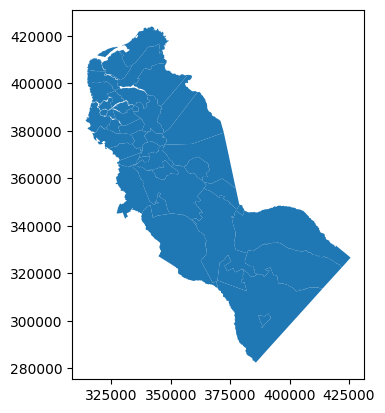

In [ ]:
#make the map
Camden.plot()

In [ ]:
! wget -q -O School_Districts_-_Unified_for_NJ%2C_3424.zip https://docs.google.com/uc?id=1gyj7YPk97WcCxU91ouoEb7cwenGe-k8h&export=download
zip_ref = zipfile.ZipFile('School_Districts_-_Unified_for_NJ%2C_3424.zip', 'r'); zip_ref.extractall(); zip_ref.close() #just unzipping
nj_utscds=gpd.read_file('School_Districts_-_Unified_for_NJ%2C_3424.shp') #load the shapefile with gpd as njC



In [ ]:
nj_utscds['NJDOE_ID_U'] = nj_utscds['NJDOE_ID_U'].str[3:]
nj_utscds['NJDOE_ID_U'] = nj_utscds['NJDOE_ID_U'].astype(int)

In [ ]:
nj_utscds = nj_utscds.rename(columns={'NJDOE_ID_U': 'dist_code'}) ## to rename

njutscds=nj_utscds[['dist_code','DIST_NAME','GEOID','geometry']] ## keeping necessary variables


In [ ]:
! wget -q -O nj-counties.zip https://docs.google.com/uc?id=1xJDhcRCkgv7k4tNCa72Oog5bohV6dTB2&export=download
zip_ref = zipfile.ZipFile('nj-counties.zip', 'r'); zip_ref.extractall(); zip_ref.close() #just unzipping
njC0=gpd.read_file('nj_counties.shp') #load the shapefile with gpd as njC

<Axes: >

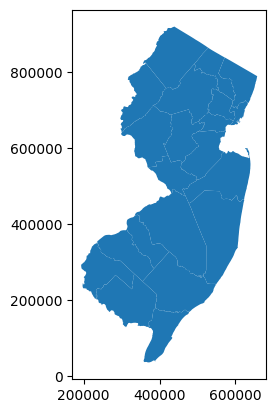

In [ ]:
njC0.plot()

In [ ]:
njC0.head(10)

,COUNTY,COUNTY_LAB,CO,GNIS_NAME,GNIS,FIPSSTCO,FIPSCO,ACRES,SQ_MILES,POP2010,...,POP1990,POP1980,POPDEN2010,POPDEN2000,POPDEN1990,POPDEN1980,REGION,Shape_Leng,Shape_Area,geometry
0,ATLANTIC,Atlantic County,ATL,County of Atlantic,882270,34001,1,390815.404215,610.649069,274549,...,275372,204615,450,414,451,335,COASTAL,650228.153906,1.702385e+10,"POLYGON ((443056.01 311529.77, 443068.44 31152..."
1,BERGEN,Bergen County,BER,County of Bergen,882271,34003,3,153490.275182,239.828555,905116,...,829592,849843,3774,3686,3459,3544,NORTHEASTERN,443326.122021,6.686010e+09,"POLYGON ((656200.963 783614.366, 656141.127 78..."
2,BURLINGTON,Burlington County,BUR,County of Burlington,882272,34005,5,525002.683590,820.316693,448734,...,395066,362542,547,516,482,442,SOUTHERN,788906.717476,2.286903e+10,"POLYGON ((436626.69 491361.78, 436701.19 49135..."
3,CAMDEN,Camden County,CAM,County of Camden,882273,34007,7,145650.507808,227.578918,513657,...,532498,471650,2257,2236,2340,2073,SOUTHERN,495010.034901,6.344511e+09,"POLYGON ((342763.99 423475.83, 342804.1 423429..."
4,CAPE MAY,Cape May County,CAP,County of Cape May,882274,34009,9,183126.574240,286.135272,97265,...,95089,82266,340,358,332,288,COASTAL,514564.858771,7.976962e+09,"POLYGON ((390389.73 177065.13, 390410.17 17705..."
5,CUMBERLAND,Cumberland County,CUM,County of Cumberland,882275,34011,11,321150.321572,501.797378,156898,...,138053,132866,313,292,275,265,SOUTHERN,704221.618565,1.398925e+10,"POLYGON ((333743.882 268331.623, 341456.371 26..."
6,ESSEX,Essex County,ESS,County of Essex,882276,34013,13,83034.859489,129.741968,783969,...,748281,850451,6044,6118,5768,6556,NORTHEASTERN,344556.557700,3.616984e+09,"POLYGON ((541167.94 755990.81, 541175.5 755969..."
7,GLOUCESTER,Gloucester County,GLO,County of Gloucester,882277,34015,15,215166.893094,336.198271,288288,...,230082,199917,857,758,684,595,SOUTHERN,560703.567470,9.372632e+09,"POLYGON ((315566.25 382993.34, 315650.44 38290..."
8,HUDSON,Hudson County,HUD,County of Hudson,882278,34017,17,32982.400794,51.535001,634266,...,553099,556972,12309,11817,10733,10808,NORTHEASTERN,381357.990132,1.436708e+09,"MULTIPOLYGON (((586210.281 660143.72, 586222.3..."
9,HUNTERDON,Hunterdon County,HUN,County of Hunterdon,882228,34019,19,279885.206384,437.320635,128349,...,107776,87361,293,279,246,200,CENTRAL,561760.929390,1.219175e+10,"POLYGON ((391770.815 705704.676, 392388.938 70..."


In [ ]:
ppe=pd.read_stata('https://github.com/OluPaul22/data/blob/main/PPEDistrict.dta?raw=true')

In [ ]:
ppe = ppe.rename(columns={'district_code': 'dist_code'}) ## changing the name
ppe['dist_code'] = ppe['dist_code'].astype(int) ## making district code an integer

In [ ]:
#merge function
nj_ppe = pd.merge(njutscds, ppe, on='dist_code',how='outer',indicator=True) #(make sure to have njC shapefile from previous sec to see what merges and what did not merge)
## 'outer' will keep all the variables either it merges or did not
nj_ppe[['dist_code','PPE','_merge']] #all good, NEW JERSEY expected not to merge

,dist_code,PPE,_merge
0,10,24095.0,both
1,20,28588.0,right_only
2,30,24937.0,both
3,40,23966.0,right_only
4,50,NaN,left_only
...,...,...,...
667,8010,14672.0,right_only
668,8050,31027.0,right_only
669,8060,29153.0,right_only
670,8065,2232.0,right_only


In [ ]:
#merge function
nj_ppe1 = pd.merge(njutscds, ppe, on='dist_code',how='inner',indicator=False) ## inner only retains those that merge. so it will get rid of New Jersey.

In [ ]:

econ_dis = pd.read_stata('https://github.com/OluPaul22/data/blob/main/econ_disadv.dta?raw=true')


In [ ]:
econ_dis = econ_dis.rename(columns={'district_code': 'dist_code'}) ## changing the name
econ_dis['dist_code'] = econ_dis['dist_code'].astype(int) ## making district code an integer

In [ ]:
#merge function
econdis = pd.merge(nj_ppe1, econ_dis, on='dist_code',how='outer',indicator=True)
econdis[['dist_code','econ_dis','_merge']]

,dist_code,econ_dis,_merge
0,10,38.7,both
1,20,5.2,right_only
2,30,6.2,both
3,40,2.3,right_only
4,60,14.3,both
...,...,...,...
664,8010,84.6,right_only
665,8050,10.9,right_only
666,8060,64.1,right_only
667,8065,78.3,right_only


In [ ]:
#merge function
econdis1 = pd.merge(nj_ppe1, econdis, on='dist_code',how='inner',indicator=False) ## inner only retains those that merge. so it will get rid of New Jersey.

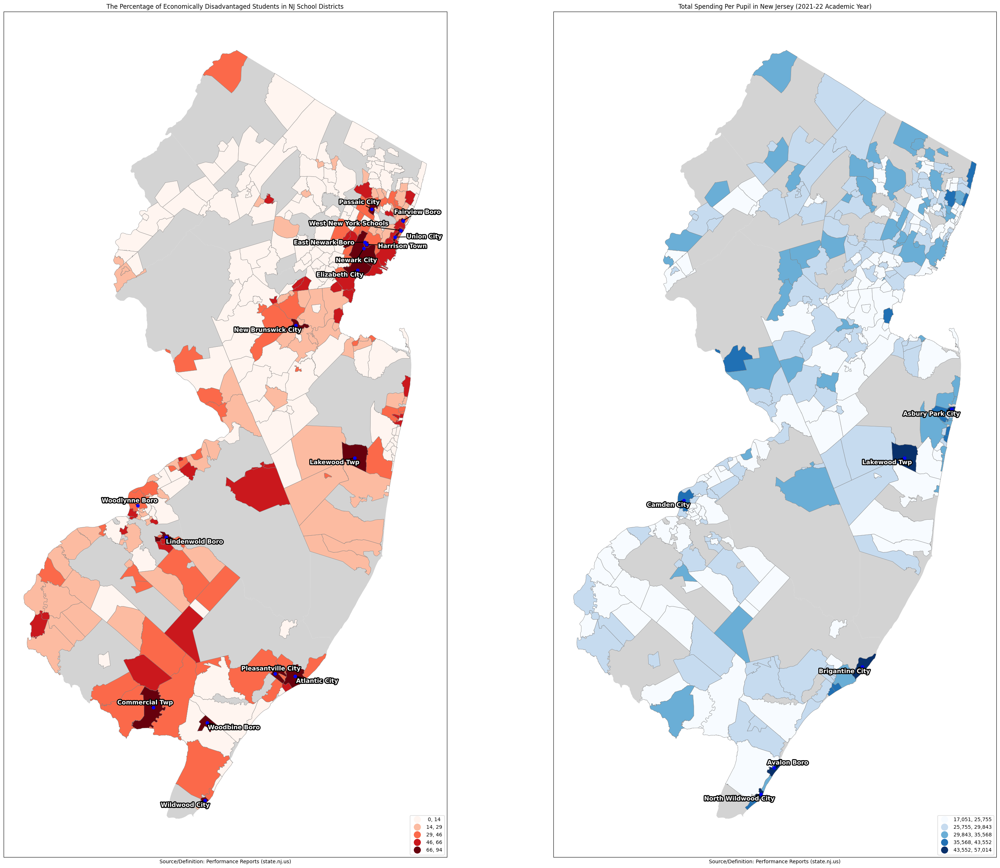

In [ ]:
from matplotlib.patheffects import withStroke
from adjustText import adjust_text
import matplotlib.pyplot as plt

# Set geometry_x as the active geometry column
econdis1 = econdis1.set_geometry('geometry_x')

# Ensure the combined GeoDataFrame (econdis1) has the correct CRS
econdis1 = econdis1.to_crs(njC0.crs)

# Define thresholds for annotations
high_disadv = econdis1[econdis1['econ_dis'] >= 66]
high_ppe = econdis1[econdis1['PPE_x'] >= 43552]

# Create side-by-side plots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(32, 24))

# Map 1: Economically Disadvantaged Students
njC0.plot(ax=ax1, color='lightgray', label='No data available')
econdis1.plot(ax=ax1, column='econ_dis', cmap='Reds',
              scheme='natural_breaks', k=5, edgecolor='grey', linewidth=0.5, legend=True,
              legend_kwds={"fmt": "{:,.0f}", 'loc': 'lower right', 'markerscale': 1.4})

# Annotate high disadvantage districts with points and labels
texts = []
for idx, row in high_disadv.iterrows():
    rep_point = row.geometry_x.representative_point()
    ax1.plot(rep_point.x, rep_point.y, 'bo')  # Plot points for debugging
    district_name = row['district_name'].replace('School District', 'SD')
    texts.append(ax1.text(rep_point.x, rep_point.y, district_name, fontsize=12,
                          ha='center', va='center', color='white', fontweight='bold',
                          path_effects=[withStroke(linewidth=4, foreground='black')]))

# Adjust the labels using adjust_text to avoid overlap and add arrows
adjust_text(texts, ax=ax1, arrowprops=dict(arrowstyle='->', color='black', lw=1.5))

ax1.set_title("The Percentage of Economically Disadvantaged Students in NJ School Districts")
ax1.set_xticks([])
ax1.set_yticks([])
ax1.set_xlabel("Source/Definition: Performance Reports (state.nj.us)")

# Map 2: Per Pupil Spending
njC0.plot(ax=ax2, color='lightgray', label='No data available')
econdis1.plot(ax=ax2, column='PPE_y', cmap='Blues',
              scheme='natural_breaks', k=5, edgecolor='grey', linewidth=0.5, legend=True,
              legend_kwds={"fmt": "{:,.0f}", 'loc': 'lower right', 'markerscale': 1.4})

# Annotate high spending districts with points and labels
texts = []
for idx, row in high_ppe.iterrows():
    rep_point = row.geometry_x.representative_point()
    ax2.plot(rep_point.x, rep_point.y, 'bo')  # Plot points for debugging
    district_name = row['district_name'].replace('School District', 'SD')
    texts.append(ax2.text(rep_point.x, rep_point.y, district_name, fontsize=12,
                          ha='center', va='center', color='white', fontweight='bold',
                          path_effects=[withStroke(linewidth=4, foreground='black')]))

# Adjust the labels using adjust_text to avoid overlap and add arrows
adjust_text(texts, ax=ax2, arrowprops=dict(arrowstyle='->', color='black', lw=1.5))

ax2.set_title("Total Spending Per Pupil in New Jersey (2021-22 Academic Year)")
ax2.set_xticks([])
ax2.set_yticks([])
ax2.set_xlabel("Source/Definition: Performance Reports (state.nj.us)")

# Adjust spacing between plots for better readability
plt.tight_layout()

# Optional: save the figure to a file
# plt.savefig('side_by_side_maps_debug.pdf', bbox_inches='tight')
# files.download('side_by_side_maps_debug.pdf')  # Uncomment if using in a Jupyter environment with file download capabilities

plt.show();



### Reducing the Statewide Map to Camden County

In [ ]:
# Drop the specified columns from the Camden_county dataset
econdis1 = econdis1.drop(columns=["DIST_NAME_y", "GEOID_y", "district_name_x", "PPE_y", "PPE_K_y", "countyname_y", "countyname_x", "district_name_y"])


In [ ]:
# Rename the specified columns in the Camden_county dataset
econdis1 = econdis1.rename(columns={"DIST_NAME_x": "dist_name","PPE_x": "PPE","PPE_K_x": "PPE_K", "GEOID_x": "GEOID"})

In [ ]:
econdis1.dtypes

,0
dist_code,int64
dist_name,object
GEOID,object
geometry_x,geometry
countyname,object
district_name,object
PPE,int32
PPE_K,float32
geometry_y,geometry
econ_dis,float64


In [ ]:
econdis1['GEOID'] = econdis1['GEOID'].astype(int) ## making GEOID code an integer

In [ ]:
econdis1 = econdis1.drop(columns=["_merge"])

In [ ]:
medinc = pd.read_stata('https://github.com/OluPaul22/data/blob/main/MedIncomeNJ.dta?raw=true')


In [ ]:
econdis1.dtypes

,0
dist_code,int64
dist_name,object
GEOID,int64
geometry_x,geometry
countyname,object
district_name,object
PPE,int32
PPE_K,float32
geometry_y,geometry
econ_dis,float64


In [ ]:
#merge function
njschdst = pd.merge(econdis1, medinc, on='GEOID',how='outer',indicator=True)

In [ ]:
#merge function
njschdst1 = pd.merge(econdis1, medinc, on='GEOID',how='inner',indicator=False) ## inner only retains those that merge. so it will get rid of New Jersey.

In [ ]:
camden_county = njschdst1[njschdst1['countyname'].str.lower() == 'camden']

In [ ]:
camden_county.head(2)

,dist_code,dist_name_x,GEOID,geometry_x,countyname,district_name,PPE,PPE_K,geometry_y,econ_dis,female,male,UniSD,dist_name_y,MedInc
32,5820,Winslow Township School District,3418060,"POLYGON ((368609.977 344389.586, 368631.27 344...",Camden,Winslow Twp,27756,27.756001,"POLYGON ((368609.977 344389.586, 368631.27 344...",35.2,45.0,55.0,18060,Winslow Township School District,87179
38,150,Audubon Public School District,3401050,"POLYGON ((333599.519 389532.256, 334908.018 38...",Camden,Audubon Public School Disrict,24431,24.431000,"POLYGON ((333599.519 389532.256, 334908.018 38...",17.8,50.0,50.0,01050,Audubon Borough School District,93670


In [ ]:
# Rename the specified columns in the Camden_county dataset
camden_county = camden_county.rename(columns={"dist_name_x": "dist_name"})

In [ ]:
camden_county.dtypes

,0
dist_code,int64
dist_name,object
GEOID,int64
geometry_x,geometry
countyname,object
district_name,object
PPE,int32
PPE_K,float32
geometry_y,geometry
econ_dis,float64


## Mapping Median Household Income in Camden County

<Axes: >

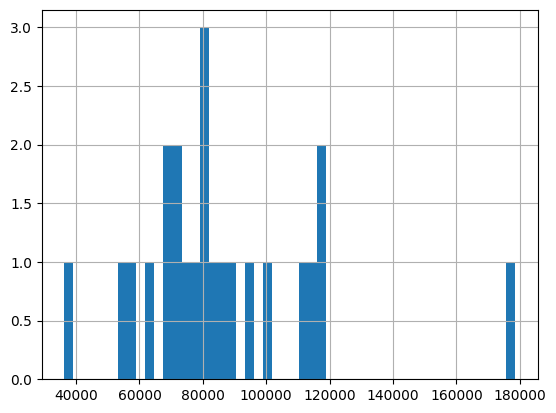

In [ ]:
camden_county.MedInc.hist(bins=50)

In [ ]:
camden_county.MedInc.sort_values()

,MedInc
253,36258
80,53645
179,58288
180,62917
118,68125
54,69176
259,71756
167,72375
108,74250
40,78909


### Checking out the classifications

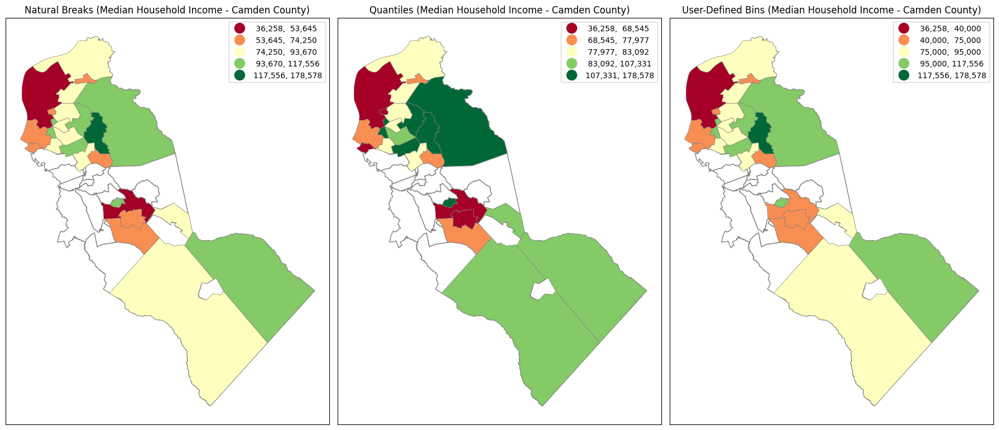

In [ ]:
from matplotlib.patheffects import withStroke
import matplotlib.pyplot as plt

# Ensure the GeoDataFrame camschdis1 has the correct CRS
camden_county = camden_county.to_crs(njC0.crs)  # Assuming njC0 has the correct CRS

# Create subplots for three maps (Natural Breaks, Quantiles, User-Defined Bins)
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 10))

# Plot 1: Natural Breaks Classification for Camden County (MedInc)
Camden.plot(ax=ax1, color='white', edgecolor='grey', label='Camden Boundary')  # Base map with Camden boundary
camden_county.plot(ax=ax1, column='MedInc', cmap='RdYlGn',
                scheme='natural_breaks', k=5, edgecolor='grey', linewidth=0.5, legend=True,
                legend_kwds={"fmt": "{:,.0f}", 'loc': 'upper right', 'markerscale': 1.4})
ax1.set_title("Natural Breaks (Median Household Income - Camden County)")
ax1.set_xticks([])
ax1.set_yticks([])

# Plot 2: Quantiles Classification for Camden County (MedInc)
Camden.plot(ax=ax2, color='white', edgecolor='grey', label='Camden Boundary')  # Base map with Camden boundary
camden_county.plot(ax=ax2, column='MedInc', cmap='RdYlGn',
                scheme='quantiles', k=5, edgecolor='grey', linewidth=0.5, legend=True,
                legend_kwds={"fmt": "{:,.0f}", 'loc': 'upper right', 'markerscale': 1.4})
ax2.set_title("Quantiles (Median Household Income - Camden County)")
ax2.set_xticks([])
ax2.set_yticks([])

# Plot 3: User-Defined Bins for Camden County (MedInc)
Camden.plot(ax=ax3, color='white', edgecolor='grey', label='Camden Boundary')  # Base map with Camden boundary
camden_county.plot(ax=ax3, column='MedInc', cmap='RdYlGn',
                scheme='user_defined', classification_kwds={'bins': [40000, 75000, 95000, 117556]},
                edgecolor='grey', linewidth=0.5, legend=True,
                legend_kwds={"fmt": "{:,.0f}", 'loc': 'upper right', 'markerscale': 1.4})
ax3.set_title("User-Defined Bins (Median Household Income - Camden County)")
ax3.set_xticks([])
ax3.set_yticks([])

# Adjust layout for better readability
plt.tight_layout()

# Show the maps
plt.show();


In [ ]:
camden_county2 = camden_county[['district_name','MedInc']].sort_values(by='MedInc', ascending=False)
sty = camden_county2.style.background_gradient(cmap='YlOrRd') ## color coding values. You can then extract it as an image and map it.
sty

,district_name,MedInc
50,Haddonfield Boro,178578
47,Haddon Heights Boro,117556
49,Cherry Hill Twp,116339
137,Laurel Springs Boro,113500
55,Haddon Twp,112352
111,Waterford Twp,99799
38,Audubon Public School Disrict,93670
173,Berlin Twp,87593
32,Winslow Twp,87179
115,Barrington Boro,82070


In [ ]:
%%capture
!pip install imgkit
!sudo apt-get install wkhtmltopdf
import imgkit

QStandardPaths: XDG_RUNTIME_DIR not set, defaulting to '/tmp/runtime-root'
Loading page (1/2)
Rendering (2/2)                                                    
Done                                                               


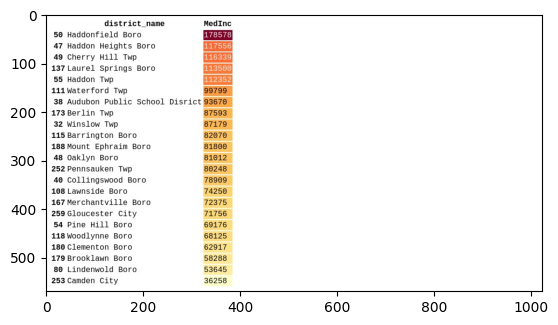

In [ ]:
imgkit.from_string(sty.to_html(), 'sty.jpg')

import matplotlib.image as mpimg
img = mpimg.imread('sty.jpg')
plt.imshow(img);

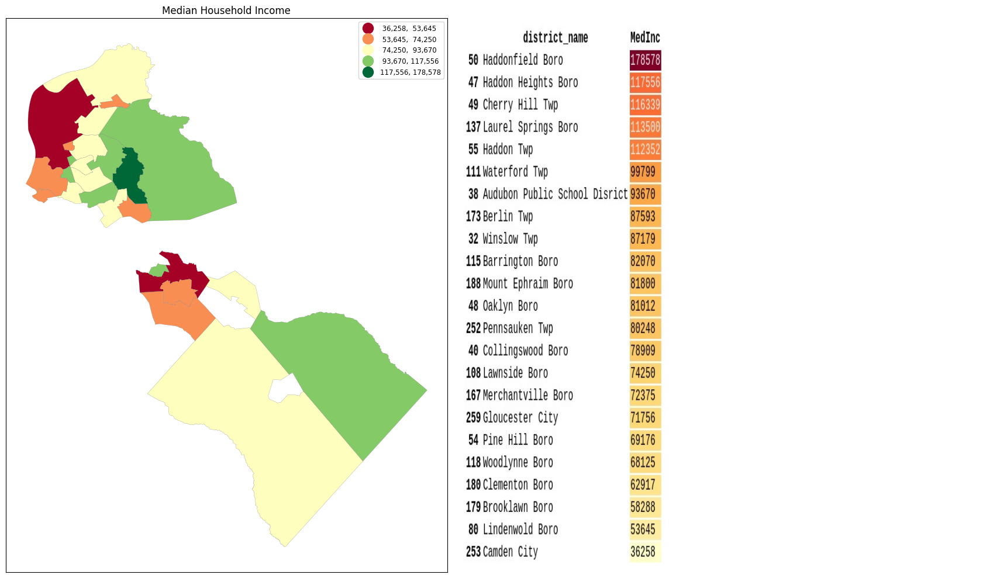

In [ ]:
fig, axs = plt.subplots(1,2, figsize=(18,10),tight_layout=True)
Camden.plot(ax=ax1, color='white', edgecolor='grey', label='Camden Boundary')  # Base map with Camden boundary
camden_county.plot(ax=axs[0],column='MedInc',legend=True,cmap='RdYlGn',scheme='natural_breaks',k=5,
         edgecolor='grey',linewidth=0.2,legend_kwds= {"fmt": "{:,.0f}",
        'loc':'upper right','title_fontsize':'medium','fontsize':'small','markerscale':1.4}) #
axs[0].title.set_text("Median Household Income")
axs[0].set_xticks([]); axs[0].set_yticks([])

axs[1].imshow(img,aspect='auto') #,  extent=[0,1,0,1]  aspect=3.5
axs[1].set_axis_off()
axs[1].set_xticks([]); axs[1].set_yticks([]);

## Mapping the percentage of economically disadvantages students in Camden County School Districts

<Axes: >

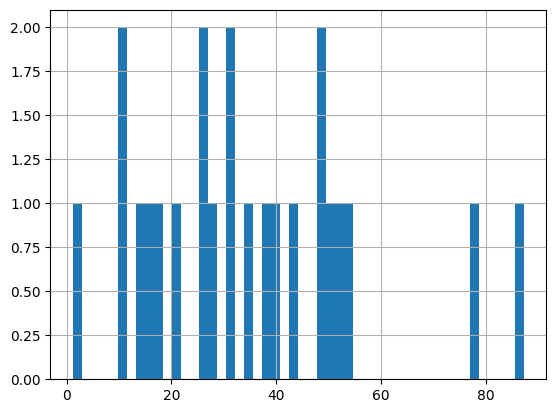

In [ ]:
camden_county.econ_dis.hist(bins=50)

In [ ]:
camden_county.econ_dis.sort_values()

,econ_dis
50,1.2
55,9.9
49,10.3
47,14.0
115,15.4
38,17.8
48,21.3
188,26.4
111,26.8
167,28.0


### Checking out the classifications (natural breaks, quantiles, and my division)

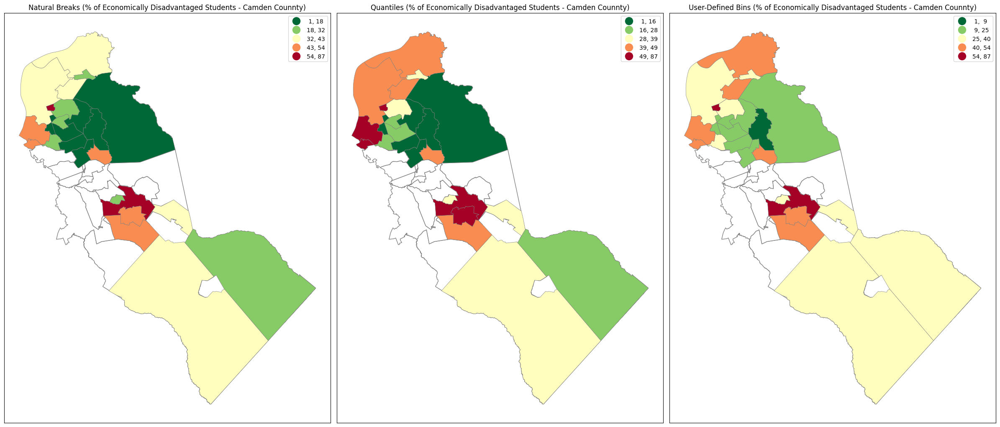

In [ ]:
from matplotlib.patheffects import withStroke
import matplotlib.pyplot as plt

# Ensure the GeoDataFrame camschdis1 has the correct CRS
camden_county = camden_county.to_crs(njC0.crs)  # Assuming njC0 has the correct CRS

# Create subplots for three maps (Natural Breaks, Quantiles, User-Defined Bins for econ_dis)
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 12))

# Plot 1: Natural Breaks Classification for Camden County (econ_dis)
Camden.plot(ax=ax1, color='white', edgecolor='grey', label='Camden Boundary')  # Base map with Camden boundary
camden_county.plot(ax=ax1, column='econ_dis', cmap='RdYlGn_r',
                scheme='natural_breaks', k=5, edgecolor='grey', linewidth=0.5, legend=True,
                legend_kwds={"fmt": "{:,.0f}", 'loc': 'upper right', 'markerscale': 1.4})
ax1.set_title("Natural Breaks (% of Economically Disadvantaged Students - Camden Counnty)")
ax1.set_xticks([])
ax1.set_yticks([])

# Plot 2: Quantiles Classification for Camden County (econ_dis)
Camden.plot(ax=ax2, color='white', edgecolor='grey', label='Camden Boundary')  # Base map with Camden boundary
camden_county.plot(ax=ax2, column='econ_dis', cmap='RdYlGn_r',
                scheme='quantiles', k=5, edgecolor='grey', linewidth=0.5, legend=True,
                legend_kwds={"fmt": "{:,.0f}", 'loc': 'upper right', 'markerscale': 1.4})
ax2.set_title("Quantiles (% of Economically Disadvantaged Students - Camden Counnty)")
ax2.set_xticks([])
ax2.set_yticks([])

# Plot 3: User-Defined Bins for Camden County (econ_dis)
Camden.plot(ax=ax3, color='white', edgecolor='grey', label='Camden Boundary')  # Base map with Camden boundary
camden_county.plot(ax=ax3, column='econ_dis', cmap='RdYlGn_r',
                scheme='user_defined', classification_kwds={'bins': [9, 25, 40, 53.8]},
                edgecolor='grey', linewidth=0.5, legend=True,
                legend_kwds={"fmt": "{:,.0f}", 'loc': 'upper right', 'markerscale': 1.4})
ax3.set_title("User-Defined Bins (% of Economically Disadvantaged Students - Camden Counnty)")
ax3.set_xticks([])
ax3.set_yticks([])

# Adjust layout for better readability
plt.tight_layout()

# Show the maps
plt.show();


## Mapping Total Spending Per Pupil in Camden County District Schools

<Axes: >

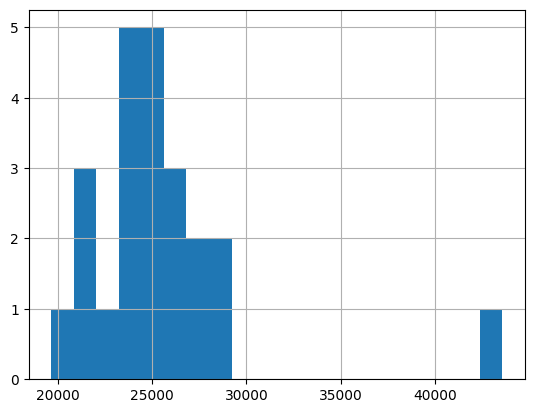

In [ ]:
camden_county.PPE.hist(bins=20)

In [ ]:
camden_county.PPE.sort_values()

,PPE
137,19645
47,21625
50,21697
167,21807
48,22731
55,23483
40,23726
179,23746
180,23833
111,23924


### Checking the classifications

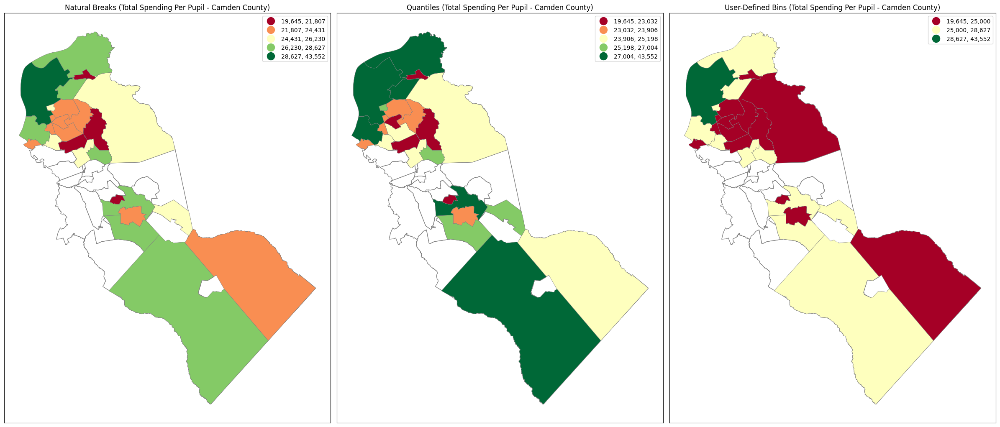

In [ ]:
from matplotlib.patheffects import withStroke
import matplotlib.pyplot as plt

# Ensure the GeoDataFrame camschdis1 has the correct CRS
camden_county = camden_county.to_crs(njC0.crs)  # Assuming njC0 has the correct CRS

# Create subplots for three maps (Natural Breaks, Quantiles, User-Defined Bins for PPE)
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 12))

# Plot 1: Natural Breaks Classification for Camden County (PPE)
Camden.plot(ax=ax1, color='white', edgecolor='grey', label='Camden Boundary')  # Camden base map
camden_county.plot(ax=ax1, column='PPE', cmap='RdYlGn',
                scheme='natural_breaks', k=5, edgecolor='grey', linewidth=0.5, legend=True,
                legend_kwds={"fmt": "{:,.0f}", 'loc': 'upper right', 'markerscale': 1.4})
ax1.set_title("Natural Breaks (Total Spending Per Pupil - Camden County)")
ax1.set_xticks([])
ax1.set_yticks([])

# Plot 2: Quantiles Classification for Camden County (PPE)
Camden.plot(ax=ax2, color='white', edgecolor='grey', label='Camden Boundary')  # Camden base map
camden_county.plot(ax=ax2, column='PPE', cmap='RdYlGn',
                scheme='quantiles', k=5, edgecolor='grey', linewidth=0.5, legend=True,
                legend_kwds={"fmt": "{:,.0f}", 'loc': 'upper right', 'markerscale': 1.4})
ax2.set_title("Quantiles (Total Spending Per Pupil - Camden County)")
ax2.set_xticks([])
ax2.set_yticks([])

# Plot 3: User-Defined Bins for Camden County (PPE)
Camden.plot(ax=ax3, color='white', edgecolor='grey', label='Camden Boundary')  # Camden base map
camden_county.plot(ax=ax3, column='PPE', cmap='RdYlGn',
                scheme='user_defined', classification_kwds={'bins': [25000, 28627]},
                edgecolor='grey', linewidth=0.5, legend=True,
                legend_kwds={"fmt": "{:,.0f}", 'loc': 'upper right', 'markerscale': 1.4})
ax3.set_title("User-Defined Bins (Total Spending Per Pupil - Camden County)")
ax3.set_xticks([])
ax3.set_yticks([])

# Adjust layout for better readability
plt.tight_layout()

# Show the maps
plt.show();

## Evaluating redistribution or spending equity by mapping Median Household Income, Percentage of Economically Disadvantaged Students, and Total Spending Per Pupil in Camden County School Districts (with user-defined bins).

* This map shows clearly that there is a good amount of redistribution or equity in total spending per pupil in Camden County.

* Exceptional cases: Despite having a low median household income and serving a high percentage of economically disadvantaged students, Clementon Borough is among the schools with the lowest total spending per pupil.

* Also, Woodlynne Boro and Linderwold Boro, with relatively low median household income and serving the highest percentage of economically disadvantaged students, should be spending more alongside Camden City.




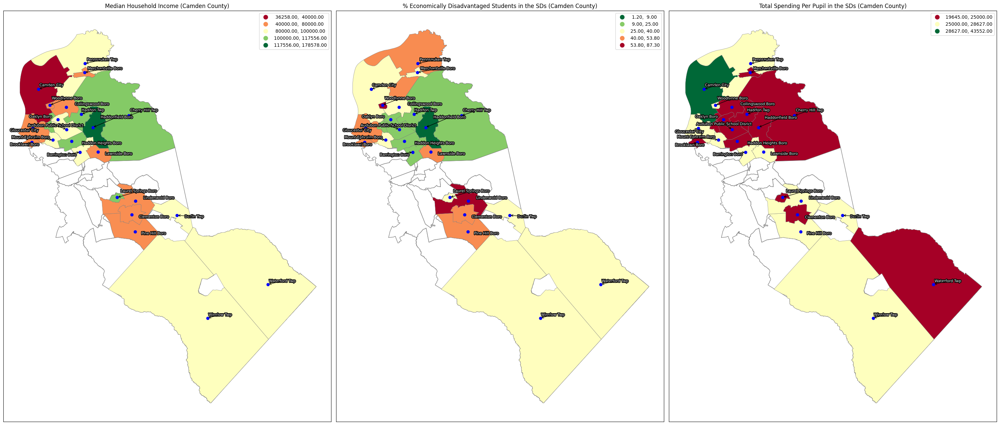

In [ ]:
from adjustText import adjust_text
from matplotlib.patheffects import withStroke
import matplotlib.pyplot as plt

# Ensure your GeoDataFrame has a valid geometry and CRS (should already be done)
camden_county = camden_county.to_crs(Camden.crs)  # Ensure CRS matches Camden

# Abbreviate long district names
camden_county['short_name'] = camden_county['district_name'].apply(lambda x: x.replace(' Township', ' Twp').replace(' Borough', ' Boro'))

# Create subplots for three maps (MedInc, econ_dis, PPE) with larger figure size
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 15))

# Path effect for white text with black outline
text_style = [withStroke(linewidth=3, foreground='black')]

# Plot 1: Median Income (MedInc) with labels and leader lines
Camden.plot(ax=ax1, color='white', edgecolor='grey', label='Camden Boundary')  # Camden base map
camden_county.plot(ax=ax1, column='MedInc', cmap='RdYlGn',
                   scheme='user_defined', classification_kwds={'bins': [40000, 80000, 100000, 117556]},
                   edgecolor='grey', linewidth=0.5, legend=True)

# Create labels with white text, black outline, and leader lines
texts = []
for idx, row in camden_county.iterrows():
    rep_point = row.geometry_x.representative_point()  # Use representative point to avoid outside centroids
    ax1.plot(rep_point.x, rep_point.y, 'bo')
    short_name = row['short_name']
    texts.append(ax1.text(rep_point.x, rep_point.y, short_name, fontsize=8, ha='center', color='white',
                          path_effects=text_style))  # White text with black outline

# Adjust text positions to avoid overlapping and add arrows with increased shrinkA
adjust_text(texts, ax=ax1, arrowprops=dict(arrowstyle='->', color='black', lw=1.0, shrinkA=5), expand_text=(1.2, 1.2))


ax1.set_title("Median Household Income (Camden County)")
ax1.set_xticks([])
ax1.set_yticks([])

# Plot 2: econ_dis (Economically Disadvantaged) with labels and leader lines
Camden.plot(ax=ax2, color='white', edgecolor='grey', label='Camden Boundary')  # Camden base map
camden_county.plot(ax=ax2, column='econ_dis', cmap='RdYlGn_r',
                   scheme='user_defined', classification_kwds={'bins': [9, 25, 40, 53.8]},
                   edgecolor='grey', linewidth=0.5, legend=True)

texts = []
for idx, row in camden_county.iterrows():
    rep_point = row.geometry_x.representative_point()
    ax2.plot(rep_point.x, rep_point.y, 'bo')
    short_name = row['short_name']
    texts.append(ax2.text(rep_point.x, rep_point.y, short_name, fontsize=8, ha='center', color='white',
                          path_effects=text_style))  # White text with black outline

adjust_text(texts, ax=ax2, arrowprops=dict(arrowstyle='->', color='black', lw=1.0, shrinkA=5), expand_text=(1.2, 1.2))

ax2.set_title("% Economically Disadvantaged Students in the SDs (Camden County)")
ax2.set_xticks([])
ax2.set_yticks([])

# Plot 3: PPE (Per Pupil Expenditure) with labels and leader lines
Camden.plot(ax=ax3, color='white', edgecolor='grey', label='Camden Boundary')  # Camden base map
camden_county.plot(ax=ax3, column='PPE', cmap='RdYlGn',
                   scheme='user_defined', classification_kwds={'bins': [25000, 28627]},
                   edgecolor='grey', linewidth=0.5, legend=True)

texts = []
for idx, row in camden_county.iterrows():
    rep_point = row.geometry_x.representative_point()
    ax3.plot(rep_point.x, rep_point.y, 'bo')
    short_name = row['short_name']
    texts.append(ax3.text(rep_point.x, rep_point.y, short_name, fontsize=8, ha='center', color='white',
                          path_effects=text_style))  # White text with black outline

adjust_text(texts, ax=ax3, arrowprops=dict(arrowstyle='->', color='black', lw=1.0, shrinkA=5), expand_text=(1.2, 1.2))

ax3.set_title("Total Spending Per Pupil in the SDs (Camden County)")
ax3.set_xticks([])
ax3.set_yticks([])

# Adjust layout for better readability
plt.tight_layout()

# Show the combined maps
plt.show();

### Scatter Plot showing inverse relationship between "% econ disadv." and "median household income"

In [ ]:
import plotly.express as px

# Assuming camschdis1 has the columns 'MedInc', 'econ_dis', and 'PPE'
fig = px.scatter(camden_county, x="MedInc", y="econ_dis",color="PPE",
                 hover_data=['district_name'],
                 labels={"MedInc": "Median Household Income","econ_dis": "% Economically Disadvantaged",
                     "PPE": "Total Spending Per Pupil"}, width=1000, height=600)

# Show the plot
fig.show()


## Merging and defining College Enrollment (2021) and Graduation Rate (2021)

In [ ]:
  colenrl = pd.read_stata('https://github.com/OluPaul22/data/blob/main/NJColEnroll.dta?raw=true')

In [ ]:
colenrl.dtypes

,0
county_name,object
dist_code,int16
district_name,object
colenr,float64


In [ ]:
colenrl2 = colenrl[['district_name','dist_code','colenr']].sort_values(by='colenr', ascending=False)
sty = colenrl2.style.background_gradient(cmap='YlOrRd') ## color coding values. You can then extract it as an image and map it.
sty

,district_name,dist_code,colenr
78,Haddonfield School District,1900,92.600000
21,Glen Rock Public School District,1760,91.400000
31,Northern Highlands Regional High School District,3700,91.200000
243,Bernards Township School District,350,91.000000
195,School District of the Chathams,785,90.400000
271,New Providence School District,3560,89.100000
110,West Essex Regional School District,5630,88.600000
102,Livingston Board of Education School District,2730,88.000000
249,Montgomery Township School District,3320,87.900000
206,Mountain Lakes Public School District,3460,87.700000


<Axes: >

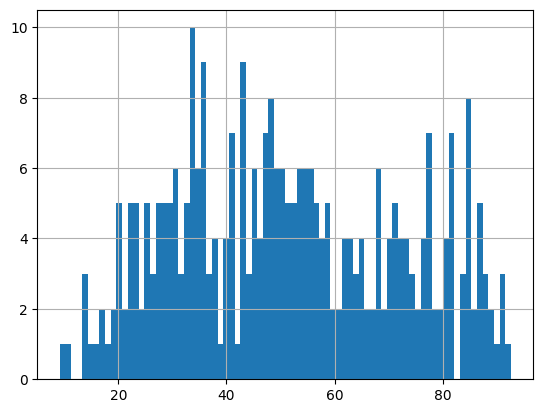

In [ ]:
colenrl.colenr.hist(bins=80)

In [ ]:
camden_county.dtypes

,0
dist_code,int64
dist_name,object
GEOID,int64
geometry_x,geometry
countyname,object
district_name,object
PPE,int32
PPE_K,float32
geometry_y,geometry
econ_dis,float64


In [ ]:
Cam_county = pd.merge(camden_county, colenrl, on='dist_code',how='outer',indicator=True)

In [ ]:
merged_rows = Cam_county[Cam_county['_merge'] == 'both'].shape[0]
print(f'Number of observations that merged: {merged_rows}')

Number of observations that merged: 12


In [ ]:
#merge function
Cam_county1 = pd.merge(camden_county, colenrl, on='dist_code',how='inner',indicator=False) ## inner only retains those that merge. so it will get rid of New Jersey.

In [ ]:
Cam_county1.dtypes

,0
dist_code,int64
dist_name,object
GEOID,int64
geometry_x,geometry
countyname,object
district_name_x,object
PPE,int32
PPE_K,float32
geometry_y,geometry
econ_dis,float64


<Axes: >

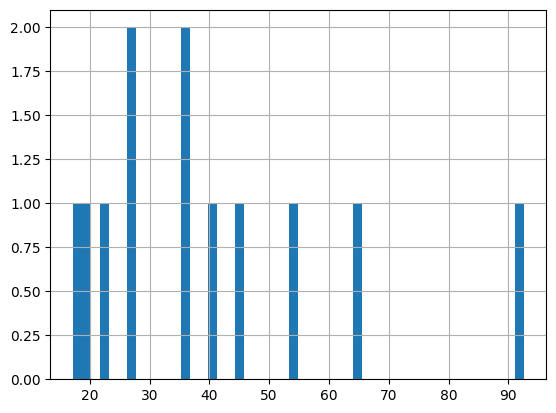

In [ ]:
Cam_county1.colenr.hist(bins=50)

In [ ]:
Cam_county1.colenr.sort_values()

,colenr
6,17.2
8,20.0
10,23.1
9,26.4
11,27.6
2,36.2
0,36.3
1,40.9
3,45.6
7,53.7


### Checking out the college enrollment classifications

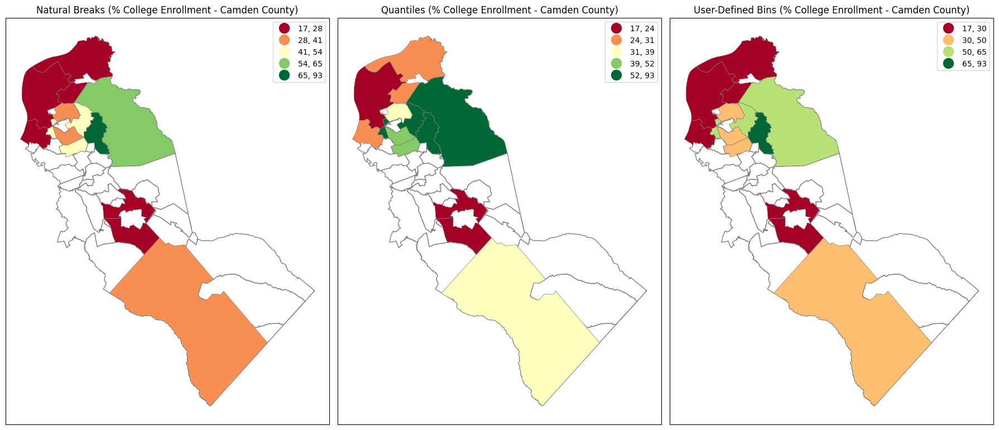

In [ ]:
from matplotlib.patheffects import withStroke
import matplotlib.pyplot as plt

# Ensure the GeoDataFrame camschdis1 has the correct CRS
Cam_county1 = Cam_county1.to_crs(njC0.crs)  # Assuming njC0 has the correct CRS

# Create subplots for three maps (Natural Breaks, Quantiles, User-Defined Bins for colenr)
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 10))

# Plot 1: Natural Breaks Classification for Camden County (colenr)
Camden.plot(ax=ax1, color='white', edgecolor='grey', label='Camden Boundary')  # Base map with Camden boundary
Cam_county1.plot(ax=ax1, column='colenr', cmap='RdYlGn',
                scheme='natural_breaks', k=5, edgecolor='grey', linewidth=0.5, legend=True,
                legend_kwds={"fmt": "{:,.0f}", 'loc': 'upper right', 'markerscale': 1.4})
ax1.set_title("Natural Breaks (% College Enrollment - Camden County)")
ax1.set_xticks([])
ax1.set_yticks([])

# Plot 2: Quantiles Classification for Camden County (colenr)
Camden.plot(ax=ax2, color='white', edgecolor='grey', label='Camden Boundary')  # Base map with Camden boundary
Cam_county1.plot(ax=ax2, column='colenr', cmap='RdYlGn',
                scheme='quantiles', k=5, edgecolor='grey', linewidth=0.5, legend=True,
                legend_kwds={"fmt": "{:,.0f}", 'loc': 'upper right', 'markerscale': 1.4})
ax2.set_title("Quantiles (% College Enrollment - Camden County)")
ax2.set_xticks([])
ax2.set_yticks([])

# Plot 3: User-Defined Bins for Camden County (colenr)
Camden.plot(ax=ax3, color='white', edgecolor='grey', label='Camden Boundary')  # Base map with Camden boundary
Cam_county1.plot(ax=ax3, column='colenr', cmap='RdYlGn',
                scheme='user_defined', classification_kwds={'bins': [30, 50, 65.4]},
                edgecolor='grey', linewidth=0.5, legend=True,
                legend_kwds={"fmt": "{:,.0f}", 'loc': 'upper right', 'markerscale': 1.4})
ax3.set_title("User-Defined Bins (% College Enrollment - Camden County)")
ax3.set_xticks([])
ax3.set_yticks([])

# Adjust layout for better readability
plt.tight_layout()

# Show the maps
plt.show();

### Merging Graduation Rate

In [ ]:
gradrate= pd.read_stata('https://github.com/OluPaul22/data/blob/main/NJGradRate.dta?raw=true')

In [ ]:
gradrate.dtypes

,0
countyname,object
dist_code,int16
district_name,object
gradrate,float64


<Axes: >

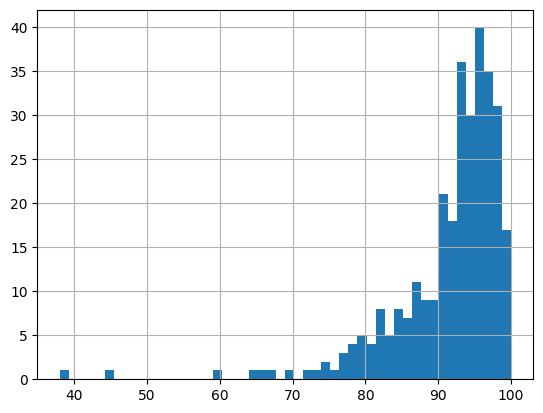

In [ ]:
gradrate.gradrate.hist(bins=50)

In [ ]:
gradrate2 = gradrate[['district_name','gradrate']].sort_values(by='gradrate', ascending=False)
sty = gradrate2.style.background_gradient(cmap='YlOrRd') ## color coding values. You can then extract it as an image and map it.
sty

,district_name,gradrate
16,Emerson Public School District,100.000000
279,Union County Vocational-Technical School District,100.000000
147,Area Vocational Technical School District of Mercer County,100.000000
184,Monmouth County Vocational School District,99.500000
8,Bergen County Vocational Technical School District,99.400000
232,Passaic County Technical-Vocational School District,99.300000
100,Glen Ridge Public School District,99.300000
90,Cumberland County Board of Vocational Education,99.100000
135,Weehawken Public School District,99.100000
146,Lawrence Township Public School District,99.000000


In [ ]:
camgradrt = pd.merge(camden_county, gradrate, on='dist_code',how='outer',indicator=True)

In [ ]:
merged_rows = camgradrt[camgradrt['_merge'] == 'both'].shape[0]
print(f'Number of observations that merged: {merged_rows}')

Number of observations that merged: 12


In [ ]:
#merge function
camgradrt1 = pd.merge(camden_county, gradrate, on='dist_code',how='inner',indicator=False) ## inner only retains those that merge. so it will get rid of New Jersey.

<Axes: >

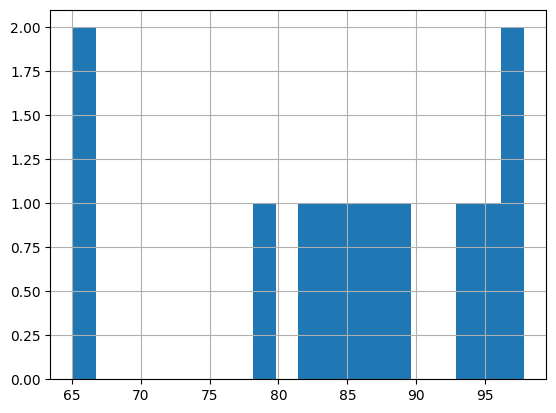

In [ ]:
camgradrt1.gradrate.hist(bins=20)

In [ ]:
camgradrt1.gradrate.sort_values()

,gradrate
8,65.1
10,66.3
0,78.3
11,82.2
9,84.5
1,85.6
6,86.8
2,88.2
7,94.2
4,94.7


### Checking out the Grad. Rate classifications

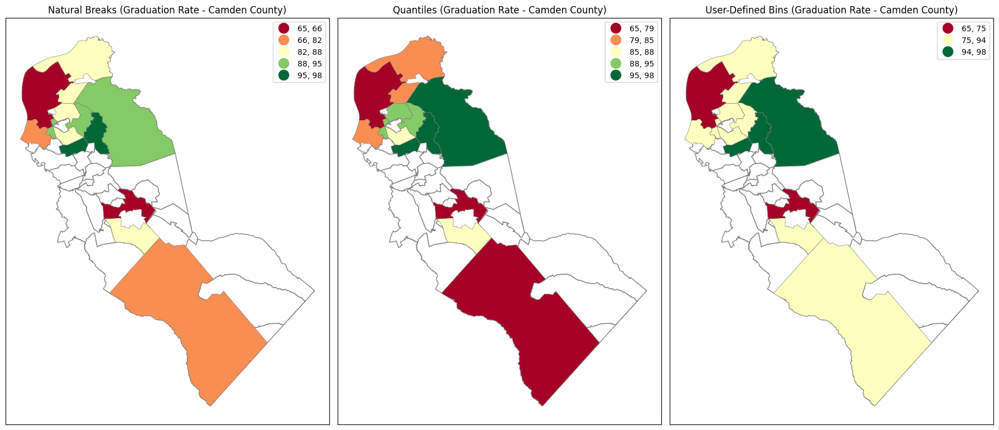

In [ ]:
from matplotlib.patheffects import withStroke
import matplotlib.pyplot as plt

# Ensure the GeoDataFrame camschdis1 has the correct CRS
camgradrt1 = camgradrt1.to_crs(njC0.crs)  # Assuming it has the correct CRS

# Create subplots for three maps (Natural Breaks, Quantiles, User-Defined Bins for gradrate)
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 10))

# Plot 1: Natural Breaks Classification for Camden County (gradrate)
Camden.plot(ax=ax1, color='white', edgecolor='grey', label='Camden Boundary')  # Base map with Camden boundary
camgradrt1.plot(ax=ax1, column='gradrate', cmap='RdYlGn',
                scheme='natural_breaks', k=5, edgecolor='grey', linewidth=0.5, legend=True,
                legend_kwds={"fmt": "{:,.0f}", 'loc': 'upper right', 'markerscale': 1.4})
ax1.set_title("Natural Breaks (Graduation Rate - Camden County)")
ax1.set_xticks([])
ax1.set_yticks([])

# Plot 2: Quantiles Classification for Camden County (gradrate)
Camden.plot(ax=ax2, color='white', edgecolor='grey', label='Camden Boundary')  # Base map with Camden boundary
camgradrt1.plot(ax=ax2, column='gradrate', cmap='RdYlGn',
                scheme='quantiles', k=5, edgecolor='grey', linewidth=0.5, legend=True,
                legend_kwds={"fmt": "{:,.0f}", 'loc': 'upper right', 'markerscale': 1.4})
ax2.set_title("Quantiles (Graduation Rate - Camden County)")
ax2.set_xticks([])
ax2.set_yticks([])

# Plot 3: User-Defined Bins for Camden County (gradrate)
Camden.plot(ax=ax3, color='white', edgecolor='grey', label='Camden Boundary')  # Base map with Camden boundary
camgradrt1.plot(ax=ax3, column='gradrate', cmap='RdYlGn',
                scheme='user_defined', classification_kwds={'bins': [75,94.2]},
                edgecolor='grey', linewidth=0.5, legend=True,
                legend_kwds={"fmt": "{:,.0f}", 'loc': 'upper right', 'markerscale': 1.4})
ax3.set_title("User-Defined Bins (Graduation Rate - Camden County)")
ax3.set_xticks([])
ax3.set_yticks([])

# Adjust layout for better readability
plt.tight_layout()

# Show the maps
plt.show();

## Evaluating the impact of Total Spending Per Pupil on Academic Outcomes using Graduation Rate and % College Enrollment as metrics

* Interestingly, all the school districts that spend less score higher on the academic performance metrics, while most schools that spend more score lower.

* In a few instances, such as Pennsauken Township, Gloucester City, Pine Hill, and Winslow Township, school district spending yields commensurate academic outcomes in the graduation rate metric, but poorly in the college enrollment metric.

* It is particularly impressive that Haddonfield School District, which spent less than all the other school districts, produces the best academic outcomes in both metrics in Camden County and is equally one of the highest in the state.

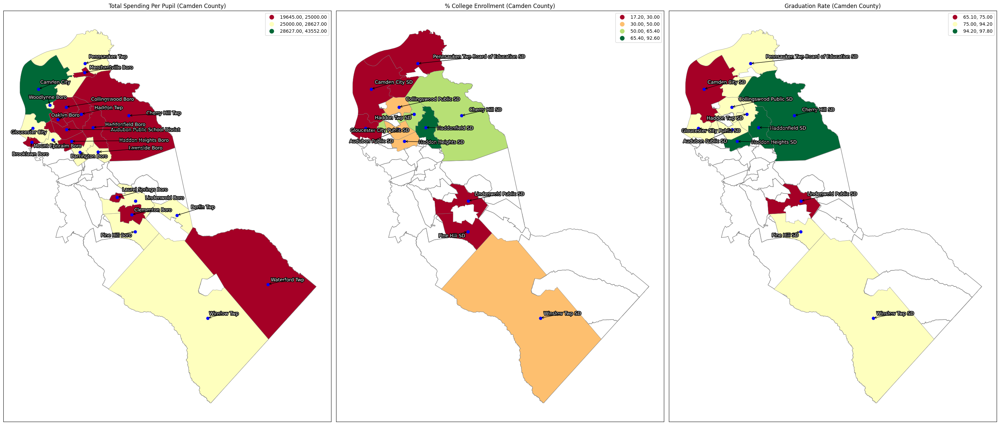

In [ ]:
from adjustText import adjust_text
from matplotlib.patheffects import withStroke
import matplotlib.pyplot as plt

# Ensure your GeoDataFrame has a valid geometry and CRS (should already be done)
camden_county = camden_county.to_crs(Camden.crs)  # Ensure CRS matches Camden

# Abbreviate long district names
camden_county['short_name'] = camden_county['district_name'].apply(lambda x: x.replace(' Township', ' Twp').replace(' Borough', ' Boro').replace(' School District', ' SD'))
Cam_county1['short_name'] = Cam_county1['dist_name'].apply(lambda x: x.replace(' Township', ' Twp').replace(' Borough', ' Boro').replace(' School District', ' SD'))
camgradrt1['short_name'] = camgradrt1['dist_name'].apply(lambda x: x.replace(' Township', ' Twp').replace(' Borough', ' Boro').replace(' School District', ' SD'))

# Create subplots for three maps (PPE, College Enrollment, Graduation Rate)
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(30, 15))

# Path effect for white text with black outline
text_style = [withStroke(linewidth=3, foreground='black')]

# Plot 1: PPE (Per Pupil Expenditure) with reduced leader line lengths
Camden.plot(ax=ax1, color='white', edgecolor='grey', label='Camden Boundary')  # Camden base map
camden_county.plot(ax=ax1, column='PPE', cmap='RdYlGn',
                scheme='user_defined', classification_kwds={'bins': [25000, 28627]},
                edgecolor='grey', linewidth=0.5, legend=True)

# Create labels with white text, black outline, and shorter leader lines

texts = []
for idx, row in camden_county.iterrows():
    rep_point = row.geometry_x.representative_point()
    ax1.plot(rep_point.x, rep_point.y, 'bo')
    short_name = row['short_name']
    texts.append(ax1.text(rep_point.x, rep_point.y, short_name, fontsize=10, ha='center', color='white',
                          path_effects=text_style))  # White text with black outline

adjust_text(texts, ax=ax1, arrowprops=dict(arrowstyle='->', color='black'), expand_text=(1.2, 1.2))

ax1.set_title("Total Spending Per Pupil (Camden County)")
ax1.set_xticks([])
ax1.set_yticks([])

# Plot 2: % College Enrollment with reduced leader line lengths
Camden.plot(ax=ax2, color='white', edgecolor='grey', label='Camden Boundary')  # Base map with Camden boundary
Cam_county1.plot(ax=ax2, column='colenr', cmap='RdYlGn',
                scheme='user_defined', classification_kwds={'bins': [30, 50, 65.4]},
                edgecolor='grey', linewidth=0.5, legend=True)

texts = []
for idx, row in Cam_county1.iterrows():
    rep_point = row.geometry_x.representative_point()
    ax2.plot(rep_point.x, rep_point.y, 'bo')
    short_name = row['short_name']
    texts.append(ax2.text(rep_point.x, rep_point.y, short_name, fontsize=10, ha='center', color='white',
                          path_effects=text_style))  # White text with black outline

adjust_text(texts, ax=ax2, arrowprops=dict(arrowstyle='->', color='black'), expand_text=(1.2, 1.2))


ax2.set_title("% College Enrollment (Camden County)")
ax2.set_xticks([])
ax2.set_yticks([])

# Plot 3: Graduation Rate with reduced leader line lengths
Camden.plot(ax=ax3, color='white', edgecolor='grey', label='Camden Boundary')  # Base map with Camden boundary
camgradrt1.plot(ax=ax3, column='gradrate', cmap='RdYlGn',
                scheme='user_defined', classification_kwds={'bins': [75,94.2]},
                edgecolor='grey', linewidth=0.5, legend=True)

texts = []
for idx, row in camgradrt1.iterrows():
    rep_point = row.geometry_x.representative_point()
    ax3.plot(rep_point.x, rep_point.y, 'bo')
    short_name = row['short_name']
    texts.append(ax3.text(rep_point.x, rep_point.y, short_name, fontsize=10, ha='center', color='white',
                          path_effects=text_style))  # White text with black outline

adjust_text(texts, ax=ax3, arrowprops=dict(arrowstyle='->', color='black'), expand_text=(1.2, 1.2))


ax3.set_title("Graduation Rate (Camden County)")
ax3.set_xticks([])
ax3.set_yticks([])

# Adjust layout for better readability
plt.tight_layout()

# Show the combined maps
plt.show();



## Graduation Rate - Scatter Plot
* Camden City School District stands out for spending the most and having the poorest academic outcomes. Even after the state took over in 2013, what could be responsible? Could the unequal distribution of resources among the 19 schools under its jurisdiction be the cause? Or how effective is the allocation of funds—either on student support services, teacher training and retention, or on non-academic, administrative, and infrastructural growth?


In [1]:
fig = px.scatter(camgradrt1, x="PPE", y="gradrate", color="MedInc",
                 hover_data=['dist_name'],
                 labels={"PPE": "Total Spending Per Pupil", "gradrate":
                         "Graduation Rate", "MedInc": "Median Household Income"},
                 width=1000, height=600)

# Show the plot
fig.show()

NameError: name 'px' is not defined

* Given the high percentage of economically disadvantaged students the Lindenwold Public School District serves, one could recommend spending more to improve the outcome of their students. While increasing spending would have been the foremost suggestion, other evidence would invalidate it, given the lack of correlation between increased spending and improved academic outcomes.

In [ ]:
fig = px.scatter(camgradrt1, x="PPE", y="gradrate", color="econ_dis",
                 hover_data=['dist_name'],
                 labels={"PPE": "Total Spending Per Pupil", "gradrate":
                         "Graduation Rate", "econ_dis": "% Economically Disadvantaged"},
                 width=1000, height=600)

# Show the plot
fig.show()

## % College Enrollment - Scatter Plot

* While four schools have graduation rates exceeding 90%, it's interesting to note that only Haddonfield School District matches this percentage in terms of college enrollment (4 years). Most schools have less than 50%.

In [ ]:
fig = px.scatter(Cam_county1, x="PPE", y="colenr", color="MedInc",
                 hover_data=['dist_name'],
                 labels={"PPE": "Total Spending Per Pupil", "colenr":
                         "% College Enrollment (4yrs)", "MedInc": "Median Household Income"},
                 width=1000, height=600)

# Show the plot
fig.show()

## Interactive MAP

In [ ]:
%%capture
!pip install mapclassify
import mapclassify

In [ ]:
import time, webbrowser, zipfile

import pandas as pd
import geopandas as gpd

from google.colab import data_table
data_table.enable_dataframe_formatter()

from google.colab import files

import folium as f
from folium.plugins import MarkerCluster, HeatMap

#will display all output not just last command
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [ ]:
f.__version__

'0.18.0'

In [ ]:
# Standardize column names to match
econdis1 = econdis1.rename(columns={"countyname": "COUNTY"})

# Ensure values in the COUNTY columns are consistent
econdis1["COUNTY"] = econdis1["COUNTY"].str.strip().str.upper()
njC0["COUNTY"] = njC0["COUNTY"].str.strip().str.upper()

# Verify the match
common_counties = set(econdis1["COUNTY"]).intersection(set(njC0["COUNTY"]))
print(f"Common counties: {len(common_counties)} matched")


Common counties: 21 matched


In [ ]:
# Aggregate spending and economic disadvantage by COUNTY
county_aggregated = econdis1.groupby("COUNTY").agg({
    "PPE_x": "mean",         # Average spending per pupil
    "PPE_K_x": "mean",       # Example for another spending column
    "DIST_NAME_x": "count",  # Example: Count of districts
    "econ_dis": "mean"       # Average economic disadvantage percentage
}).reset_index()

# Rename aggregated columns for clarity
county_aggregated.rename(columns={
    "PPE_x": "avg_spending",
    "PPE_K_x": "avg_spending_k",
    "DIST_NAME_x": "district_count",
    "econ_dis": "avg_econ_dis"
}, inplace=True)

print(county_aggregated.head())


       COUNTY  avg_spending  avg_spending_k  district_count  avg_econ_dis
0    ATLANTIC  30871.846154       30.871845              13     34.792308
1      BERGEN  27521.510638       27.521511              47     17.200000
2  BURLINGTON  26684.470588       26.684469              17     29.829412
3      CAMDEN  25495.434783       25.495436              23     35.121739
4    CAPE MAY  35119.600000       35.119598              10     28.510000


In [ ]:
# Ensure both datasets have consistent COUNTY formats
njC0["COUNTY"] = njC0["COUNTY"].str.strip().str.upper()
county_aggregated["COUNTY"] = county_aggregated["COUNTY"].str.strip().str.upper()

# Merge datasets on COUNTY
merged_data = njC0.merge(county_aggregated, on="COUNTY", how="left")
print(merged_data.head())

       COUNTY         COUNTY_LAB   CO             GNIS_NAME    GNIS FIPSSTCO  \
0    ATLANTIC    Atlantic County  ATL    County of Atlantic  882270    34001   
1      BERGEN      Bergen County  BER      County of Bergen  882271    34003   
2  BURLINGTON  Burlington County  BUR  County of Burlington  882272    34005   
3      CAMDEN      Camden County  CAM      County of Camden  882273    34007   
4    CAPE MAY    Cape May County  CAP    County of Cape May  882274    34009   

  FIPSCO          ACRES    SQ_MILES  POP2010  ...  POPDEN1990  POPDEN1980  \
0      1  390815.404215  610.649069   274549  ...         451         335   
1      3  153490.275182  239.828555   905116  ...        3459        3544   
2      5  525002.683590  820.316693   448734  ...         482         442   
3      7  145650.507808  227.578918   513657  ...        2340        2073   
4      9  183126.574240  286.135272    97265  ...         332         288   

         REGION     Shape_Leng    Shape_Area  \
0       

In [ ]:
merged_data.head(4)

,COUNTY,COUNTY_LAB,CO,GNIS_NAME,GNIS,FIPSSTCO,FIPSCO,ACRES,SQ_MILES,POP2010,...,POPDEN1990,POPDEN1980,REGION,Shape_Leng,Shape_Area,geometry,avg_spending,avg_spending_k,district_count,avg_econ_dis
0,ATLANTIC,Atlantic County,ATL,County of Atlantic,882270,34001,1,390815.404215,610.649069,274549,...,451,335,COASTAL,650228.153906,1.702385e+10,"POLYGON ((443056.01 311529.77, 443068.44 31152...",30871.846154,30.871845,13,34.792308
1,BERGEN,Bergen County,BER,County of Bergen,882271,34003,3,153490.275182,239.828555,905116,...,3459,3544,NORTHEASTERN,443326.122021,6.686010e+09,"POLYGON ((656200.963 783614.366, 656141.127 78...",27521.510638,27.521511,47,17.200000
2,BURLINGTON,Burlington County,BUR,County of Burlington,882272,34005,5,525002.683590,820.316693,448734,...,482,442,SOUTHERN,788906.717476,2.286903e+10,"POLYGON ((436626.69 491361.78, 436701.19 49135...",26684.470588,26.684469,17,29.829412
3,CAMDEN,Camden County,CAM,County of Camden,882273,34007,7,145650.507808,227.578918,513657,...,2340,2073,SOUTHERN,495010.034901,6.344511e+09,"POLYGON ((342763.99 423475.83, 342804.1 423429...",25495.434783,25.495436,23,35.121739


<Axes: >

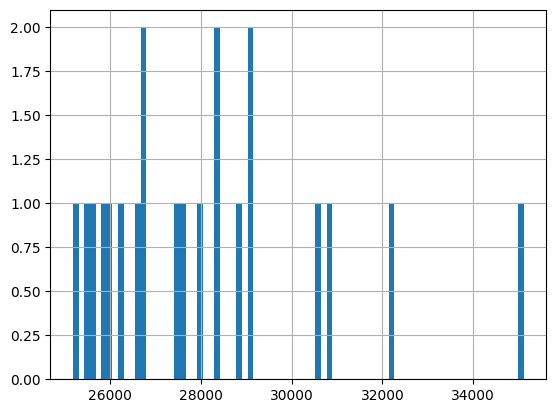

In [ ]:
merged_data.avg_spending.hist(bins=80)

<Axes: >

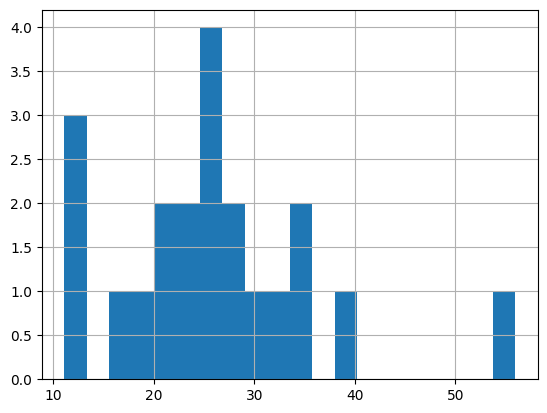

In [ ]:
merged_data.avg_econ_dis.hist(bins=20)

In [ ]:
from shapely.geometry import Polygon, MultiPolygon, Point, LineString
import geopandas as gpd

# Ensure `econdis1` is a GeoDataFrame
if not isinstance(econdis1, gpd.GeoDataFrame):
    econdis1 = gpd.GeoDataFrame(econdis1, geometry='geometry_x')

# Check for invalid geometries
print("Checking for invalid geometries...")
valid_geometry_types = (Polygon, MultiPolygon)  # Add other types if necessary
invalid_geometries = econdis1[~econdis1['geometry_x'].apply(lambda x: isinstance(x, valid_geometry_types))]
print(f"Invalid geometries: {len(invalid_geometries)}")

# Attempt to fix invalid geometries if necessary
if len(invalid_geometries) > 0:
    print("Attempting to fix invalid geometries...")
    econdis1['geometry_x'] = econdis1['geometry_x'].apply(lambda x: shape(x) if isinstance(x, dict) else x)


Checking for invalid geometries...
Invalid geometries: 0


In [ ]:
from folium import GeoJson, GeoJsonTooltip, GeoJsonPopup

# Create the map
m = f.Map(location=[40, -75], tiles='Cartodb Positron', zoom_start=8)

# Spending Choropleth
f.Choropleth(
    geo_data=merged_data,  # Pass the GeoJSON data here
    name="Average Spending Per Pupil by County",
    data=merged_data,
    columns=["COUNTY", "avg_spending"],
    key_on="feature.properties.COUNTY",
    fill_color="RdYlGn",
    fill_opacity=1,
    line_opacity=0.2,
    bins=[10000, 27000, 30000, 34000, 50000],  # Adjusted bins
    legend_name="Average Spending Per Pupil in NJ Counties"
).add_to(m)

# Add interactivity with GeoJson layer for tooltips and popups
geojson_layer = GeoJson(
    data=merged_data,  # Use the GeoJSON data
    name="Interactive Counties",
    tooltip=GeoJsonTooltip(
        fields=["COUNTY", "avg_spending", "avg_econ_dis"],  # Fields to display
        aliases=["County:", "Avg Spending:", "Economic Disadvantage (%):"],  # Labels
        localize=True,  # Automatically format numbers
        sticky=True  # Tooltip stays open while hovering
    ),
    popup=GeoJsonPopup(
        fields=["COUNTY", "avg_spending", "avg_econ_dis"],  # Fields to display
        aliases=["County:", "Avg Spending:", "Economic Disadvantage (%):"],  # Labels
        localize=True  # Automatically format popup content
    )
)

# Add the GeoJson layer for interactivity
geojson_layer.add_to(m)

# Add Layer Control
f.LayerControl().add_to(m)

# Display the map
m  # Uncomment in a notebook to view the map
